# Summary
#### pandas on spark DF 는 스파크 엔진 위에서 동작하는 API
- pyspark DF 와 유사하게 lazy evaluation 하며, catalyst optimzer 를 통해 최적화됨
    - 빅데이터 병렬 처리에 유리하며, 
    - 빅데이터가 아닌 경우에도 pandas DF와 비교하여 optimizer의 영향으로 효율적인 부분 존재
- 빅데이터를 interactively 시각화하는데에 pandas on spark DF 를 활용하는 것이 유용
- pandas on spark DF를 이용하여 pandas, sql 문법을 통합적으로 활용할 수 있고 streaming 처리도 가능
- 아직까진 external pandas library 지원이 안되는 것들이 많음
    - `__iter__`() 지원 안됨 -> min(pandasDF), max() 지원 안됨 -> pandas_on_spark_DF.max() 이렇게 사용해야 함
    - plot 관련해서도 matplotlib, plotly 를 directly 사용하는 경우는 지원이 안됨
    - pandas on spark DF 에서 .plot() 을 하는 방식으로 지원
    - prophet model 등의 외부 라이브러리는 대부분 pandas on spark DF 를 지원하지 않을 것으로 보임

#### 결론적으로 빅데이터 시각화 측면에서 기존과 비교하여 pandas on spark DF 의 활용이 얼마나 효과가 있는지가 관건
- 기존의 빅데이터 시각화 방식은,
    - .toPandas() 로 변환하여 시각화 -> 빅데이터에서 OOM 에러 발생
    - databricks 제품 (databricks runtime)을 사용하여 display() 하는 방식
- pandas on spark DF 는 default plot 으로 plotly 를 사용함
    - 주피터 노트북에서 plotly 지원 안함?

In [4]:
from pyspark.sql import SparkSession
import pyspark.sql.functions as F

In [5]:
spark = SparkSession.builder.appName("spark-poc").getOrCreate()

In [6]:
spark

# Pandas API

In [7]:
import pyspark.pandas as ps
import numpy as np
import pandas as pd

In [8]:
trip_files = "/Users/krafton/project/personal/spark-poc/data/*"
trips_df = spark.read.csv(f"file:///{trip_files}", inferSchema=True, header=True)

In [9]:
print(type(trips_df))
trips_df.show(1)

<class 'pyspark.sql.dataframe.DataFrame'>
+--------+--------------------+---------------------+---------------+-------------+----------+------------------+------------+------------+------------+-----------+-----+-------+----------+------------+---------------------+------------+--------------------+
|VendorID|tpep_pickup_datetime|tpep_dropoff_datetime|passenger_count|trip_distance|RatecodeID|store_and_fwd_flag|PULocationID|DOLocationID|payment_type|fare_amount|extra|mta_tax|tip_amount|tolls_amount|improvement_surcharge|total_amount|congestion_surcharge|
+--------+--------------------+---------------------+---------------+-------------+----------+------------------+------------+------------+------------+-----------+-----+-------+----------+------------+---------------------+------------+--------------------+
|       1| 2021-01-01 00:30:10|  2021-01-01 00:36:12|              1|          2.1|         1|                 N|         142|          43|           2|        8.0|  3.0|    0.5|   

In [10]:
pdf = trips_df.to_pandas_on_spark()
print(type(pdf))
pdf.head(1)

<class 'pyspark.pandas.frame.DataFrame'>


,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge
0,1,2021-01-01 00:30:10,2021-01-01 00:36:12,1,2.1,1,N,142,43,2,8.0,3.0,0.5,0.0,0.0,0.3,11.8,2.5


In [11]:
raw_pdf = trips_df.toPandas()
print(type(raw_pdf))
raw_pdf.head(1)

<class 'pandas.core.frame.DataFrame'>


,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge
0,1.0,2021-01-01 00:30:10,2021-01-01 00:36:12,1.0,2.1,1.0,N,142,43,2.0,8.0,3.0,0.5,0.0,0.0,0.3,11.8,2.5


# Functionalities

In [10]:
filtered_raw_pdf = raw_pdf.loc[(raw_pdf.trip_distance >0) & (raw_pdf.trip_distance<100) & (raw_pdf.total_amount>0) & (raw_pdf.total_amount<100)]
filtered_raw_pdf[['trip_distance', 'total_amount']].describe()

,trip_distance,total_amount
count,1.342150e+06,1.342150e+06
mean,2.906704e+00,1.739300e+01
std,3.579382e+00,1.147874e+01
min,1.000000e-02,1.000000e-02
25%,1.020000e+00,1.080000e+01
50%,1.700000e+00,1.380000e+01
75%,3.060000e+00,1.896000e+01
max,9.550000e+01,9.996000e+01


In [11]:
filtered_pdf = ps.sql("""
select trip_distance, total_amount
from {pdf}
where trip_distance >0 and trip_distance <100 and total_amount>0 and total_amount<100
"""
)
filtered_pdf.describe()

,trip_distance,total_amount
count,1.342150e+06,1.342150e+06
mean,2.906704e+00,1.739300e+01
std,3.579382e+00,1.147874e+01
min,1.000000e-02,1.000000e-02
25%,1.020000e+00,1.080000e+01
50%,1.700000e+00,1.380000e+01
75%,3.060000e+00,1.896000e+01
max,9.550000e+01,9.996000e+01


# Visualization

In [12]:
import matplotlib.pyplot as plt
import plotly as py
import plotly.express as px

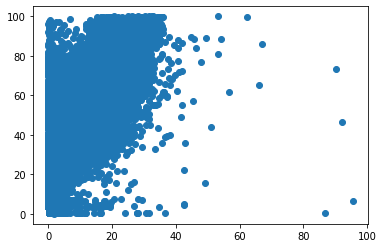

In [13]:
plt.plot(filtered_raw_pdf.trip_distance, filtered_raw_pdf.total_amount, 'o')

KeyError: 'Key length (2) exceeds index depth (1)'

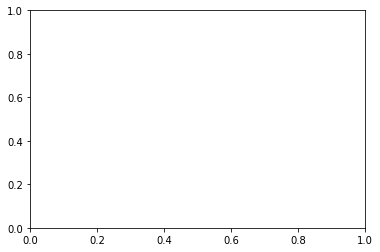

In [22]:
plt.plot(filtered_pdf.trip_distance, filtered_raw_pdf.total_amount, 'o')

In [23]:
px.scatter(filtered_raw_pdf, x='trip_distance', y='total_amount')

In [40]:
px.scatter(filtered_pdf, x='trip_distance', y='total_amount')

ValueError: Value of 'x' is not the name of a column in 'data_frame'. Expected one of [0] but received: trip_distance

### pandas on spark DF is not supported by plot library...
- using matplotlib, plotly directrly is not supported
- instead, using DF.plot() is possible

<AxesSubplot:>

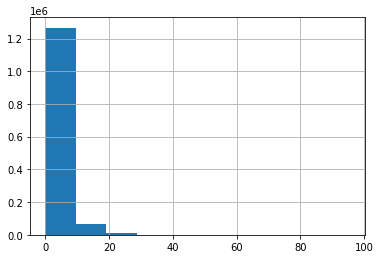

In [14]:
### pandas DF use matplotlib as a default
filtered_raw_pdf.trip_distance.hist()

In [29]:
### pandas on spark DF use plotly as a default
filtered_pdf.trip_distance.hist()
# filtered_pdf.trip_distance.hist(width=50, heigth=100)

<AxesSubplot:xlabel='trip_distance', ylabel='total_amount'>

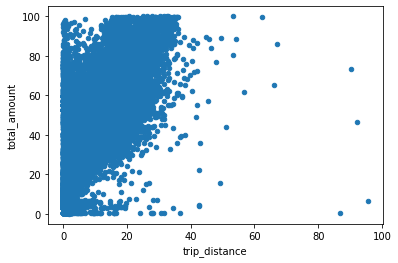

In [17]:
### pandas DF use matplotlib as a default
filtered_raw_pdf[['trip_distance', 'total_amount']]\
    .plot.scatter(x='trip_distance', y='total_amount')

In [22]:
filtered_pdf.plot.scatter(x='trip_distance', y='total_amount', width=600, height=400)

# compatibility
- prophet library does not support to pandas on spark DF

In [35]:
from prophet import Prophet

In [36]:
path = 'https://raw.githubusercontent.com/jbrownlee/Datasets/master/monthly-car-sales.csv'
df = pd.read_csv(path, header=0)
print(df.shape)
print(df.head())

(108, 2)
     Month  Sales
0  1960-01   6550
1  1960-02   8728
2  1960-03  12026
3  1960-04  14395
4  1960-05  14587


<AxesSubplot:>

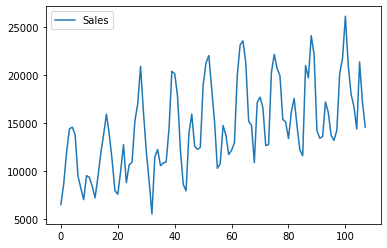

In [41]:
df.plot()

In [43]:
df.columns = ['ds', 'y']
df['ds']= pd.to_datetime(df['ds'])

m = Prophet()
m.fit(df)

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/opt/anaconda3/envs/spark-airflow/lib/python3.8/site-packages/prophet/forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



/opt/anaconda3/envs/spark-airflow/lib/python3.8/site-packages/prophet/forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/opt/anaconda3/envs/spark-airflow/lib/python3.8/site-packages/prophet/forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



Figure(720x432)


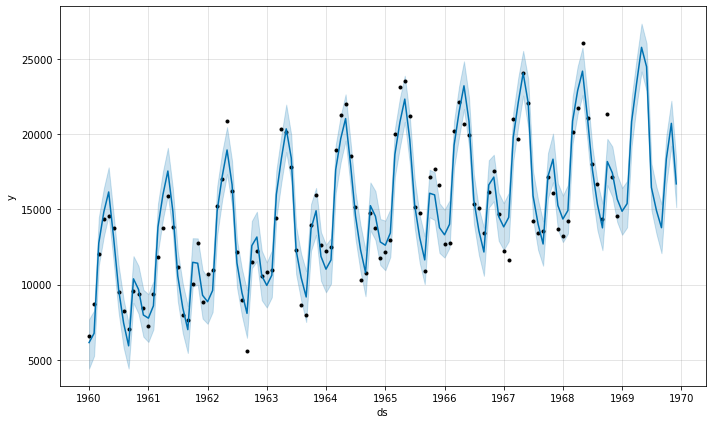

In [81]:
future = m.make_future_dataframe(periods=12, freq='m')
forecast = m.predict(future)
fig = m.plot(forecast)
print(fig)

In [75]:
dd=spark.createDataFrame(df.tail(100))
dd.show(1)

+-------------------+----+
|                 ds|   y|
+-------------------+----+
|1960-09-01 00:00:00|7049|
+-------------------+----+
only showing top 1 row



In [82]:
ps_df = dd.to_pandas_on_spark()
ps_df.head()

,ds,y
0,1960-09-01,7049
1,1960-10-01,9545
2,1960-11-01,9364
3,1960-12-01,8456
4,1961-01-01,7237


In [89]:
ps_df.plot.line(x='ds', y='y')

In [90]:
m2 = Prophet()
m2.fit(ps_df)

PandasNotImplementedError: The method `pd.Series.__iter__()` is not implemented. If you want to collect your data as an NumPy array, use 'to_numpy()' instead.

### magic func

In [91]:
%%sql

UsageError: Cell magic `%%sql` not found.
